# Lesson 8: Variational Auto Encoders

*Teachers:* Fares Schulz, Lina Campanella

In this course we will cover:
1. Optimization techniques
2. Regularization techniques
3. Transfer learning

In [74]:
import random
import torch
import torch.nn as nn
import torchvision
import torchinfo
import numpy as np
from tqdm import tqdm
import torchaudio
import torchaudio.transforms as T
import librosa
from pathlib import Path
from torch.utils.data import Dataset, DataLoader, random_split

import matplotlib.pyplot as plt
from sklearn import manifold


SEED = 42

def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)

set_seed(SEED)

In [75]:
DATA_DIR = "/Users/Lina/Documents/Homework/MA_AKT/tu studio/DL4AD/datasets/AudioMNIST/data"  # Change this to your path

In [76]:
class AudioMNISTSpectrumExtractor:
    def __init__(self, n_fft=510, hop_length=256, target_length=None):
        self.n_fft = n_fft  # n_fft=510 gives 256 frequency bins (n_fft//2 + 1)
        self.hop_length = hop_length
        self.win_length = n_fft
        self.target_length = target_length  
        self.sr = None
        self.spectrogram_transform = T.Spectrogram(n_fft=self.n_fft, win_length=self.win_length, hop_length=self.hop_length, power=2.0)
        
        
    def get_spectrogram(self, audio_path):
        # Load audio with librosa (works reliably on macOS without backend issues)
        y, sr = librosa.load(audio_path)
        self.sr = sr  # Store sample rate
        # Convert to torch tensor and add channel dimension
        waveform = torch.from_numpy(y).unsqueeze(0).float()
        waveform = self.pad_or_crop_audio(waveform)
        # Apply spectrogram transform
        spectrogram = self.spectrogram_transform(waveform)
        # Normalize spectrogram
        spectrogram = torch.div(spectrogram, spectrogram.max())
        return spectrogram
    
    def pad_or_crop_audio(self, waveform):
        current_length = waveform.shape[-1]
        if current_length < self.target_length:
            # Pad with zeros
            padding = self.target_length - current_length
            waveform = torch.nn.functional.pad(waveform, (0, padding))
        elif current_length > self.target_length:
            # Crop the waveform - need to index the time dimension correctly
            waveform = waveform[:, :self.target_length]

        return waveform
        

def load_audiomnist_dataset(data_dir, max_samples_per_speaker=None):
    """
    Load AudioMNIST dataset and extract features.
    
    Expected directory structure:
    data_dir/
        01/  (speaker 1)
            0_01_0.wav
            0_01_1.wav
            ...
            9_01_49.wav
        02/  (speaker 2)
            0_02_0.wav
            ...
        ...
        60/  (speaker 60)
    
    Returns:
        features: numpy array of shape (n_samples, n_features)
        labels: numpy array of shape (n_samples,) - digit labels
        speakers: numpy array of shape (n_samples,) - speaker IDs
    """
    extractor = AudioMNISTSpectrumExtractor(target_length=16128)  # 16128 samples = 64 frames with hop_length=256 (since (16128-510)/256 + 1 ≈ 64)

    
    spectrogram_list = []
    labels_list = []
    speakers_list = []
    
    data_path = Path(data_dir)
    
    print("Loading AudioMNIST dataset...")
    
    # Iterate through all speaker directories (01-60)
    for speaker_id in range(1, 6):  # AudioMNIST has 60 speakers
        speaker_dir = data_path / str(speaker_id).zfill(2)
        
        if not speaker_dir.exists():
            continue  # Skip missing speaker directories
        
        audio_files = sorted(speaker_dir.glob("*.wav"))
        
        if max_samples_per_speaker:
            audio_files = audio_files[:max_samples_per_speaker]
        
        samples_loaded = 0
        for audio_file in audio_files:
            try:
                # Extract features
                spectrogram = extractor.get_spectrogram(audio_file)
                
                # Parse filename to get digit (format: digit_speaker_repetition.wav)
                parts = audio_file.stem.split('_')
                digit = int(parts[0])

                # Convert tensor to numpy before appending
                spectrogram_list.append(spectrogram.numpy())
                labels_list.append(digit)
                speakers_list.append(speaker_id)
                samples_loaded += 1
                
            except Exception as e:
                print(f"Error processing {audio_file}: {e}")
                continue
        
        if samples_loaded > 0:
            print(f"Speaker {speaker_id:02d}: {samples_loaded} samples loaded")
    
    spectrogram = np.array(spectrogram_list)
    labels = np.array(labels_list)
    speakers = np.array(speakers_list)
    
    print(f"\nTotal samples: {len(spectrogram)}")
    print(f"Feature shape: {spectrogram[0].shape}")  # Now this will show (num_samples, 1, 257, 141)
    print(f"Unique digits: {sorted(np.unique(labels))}")
    print(f"Unique speakers: {len(np.unique(speakers))}")
    
    return spectrogram, labels, speakers

X, y, _ = load_audiomnist_dataset(DATA_DIR, max_samples_per_speaker=None)

# Convert to numpy arrays
X = np.array(X)   
y = np.array(y) 

Loading AudioMNIST dataset...
Speaker 01: 500 samples loaded
Speaker 02: 500 samples loaded
Speaker 03: 500 samples loaded
Speaker 04: 500 samples loaded
Speaker 05: 500 samples loaded

Total samples: 2500
Feature shape: (1, 256, 64)
Unique digits: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Unique speakers: 5


In [77]:
# Class to create our data set with torch.utils.data.Dataset
class WaveformDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)  # Channel dimension already exists from spectrogram
        self.y = torch.tensor(y, dtype=torch.long)

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]
    
dataset = WaveformDataset(X, y)

train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=128)

print(f"Training samples: {len(train_dataset)}")
print(f"Test samples: {len(test_dataset)}")


Training samples: 2000
Test samples: 500


Shape of the spectrogram tensor: torch.Size([16, 1, 256, 64])


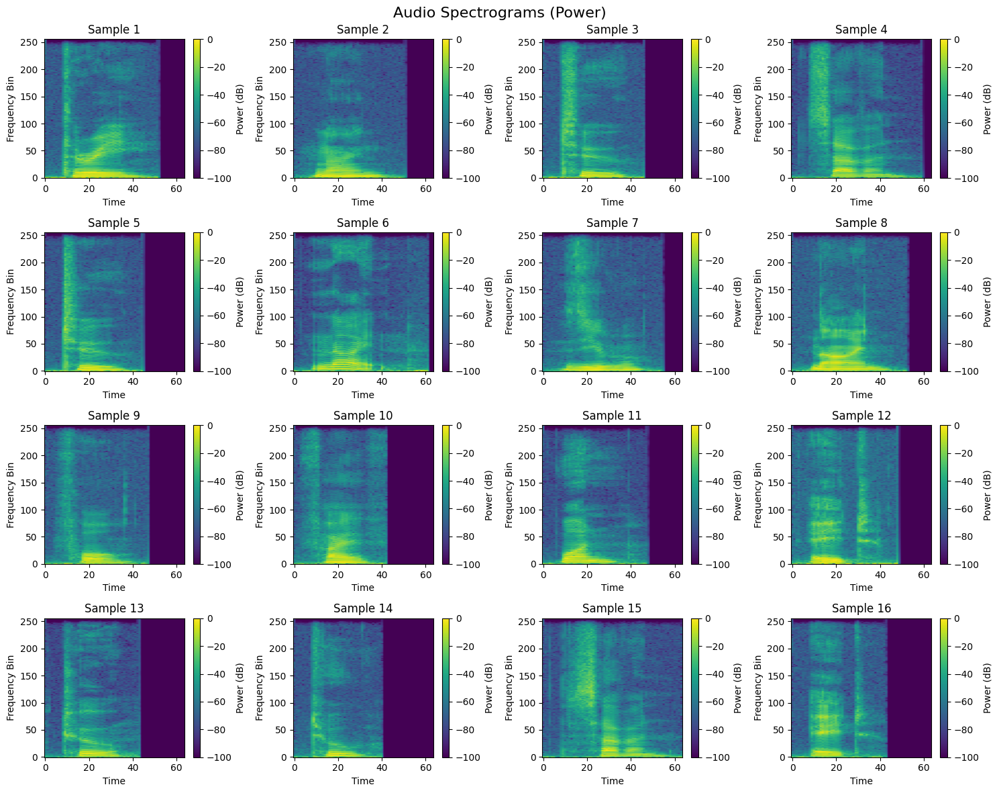

In [78]:
# Show some spectrograms

# Get a batch of spectrograms
spectrograms, labels = next(iter(train_loader))
spectrograms_to_show = spectrograms[:16]
print("Shape of the spectrogram tensor:", spectrograms_to_show.shape)

# Create subplots to show individual spectrograms
fig, axes = plt.subplots(4, 4, figsize=(15, 12))
fig.suptitle('Audio Spectrograms (Power)', fontsize=16)

for idx, ax in enumerate(axes.flat):
    if idx < len(spectrograms_to_show):
        # Get single spectrogram and squeeze channel dimension
        spec = spectrograms_to_show[idx].squeeze().numpy()
        
        # Convert to dB scale for better visualization
        spec_db = 10 * np.log10(spec + 1e-10)
        
        # Plot spectrogram
        im = ax.imshow(spec_db, aspect='auto', origin='lower', cmap='viridis')
        ax.set_title(f'Sample {idx + 1}')
        ax.set_xlabel('Time')
        ax.set_ylabel('Frequency Bin')
        
        # Add colorbar for each subplot
        plt.colorbar(im, ax=ax, label='Power (dB)')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

In [79]:
from IPython.display import Audio, display

def spectrogram_to_audio(spectrogram, n_fft=510, hop_length=256, sr=22050):
    """
    Convert a spectrogram back to audio using Griffin-Lim algorithm.
    
    Args:
        spectrogram: tensor of shape (1, freq_bins, time_frames) or (freq_bins, time_frames)
        n_fft: FFT size
        hop_length: hop length
        sr: sample rate
    
    Returns:
        audio waveform as numpy array
    """
    # Ensure spectrogram is on CPU and has correct shape
    if len(spectrogram.shape) == 3 and spectrogram.shape[0] == 1:
        spectrogram = spectrogram.squeeze(0)  # Remove batch/channel dim
    
    spectrogram = spectrogram.cpu()
    
    # Create Griffin-Lim transform
    griffin_lim = T.GriffinLim(
        n_fft=n_fft,
        win_length=n_fft,
        hop_length=hop_length,
        n_iter=32
    )
    
    # Reconstruct audio
    audio = griffin_lim(spectrogram)
    
    return audio.numpy()

def play_audio_from_spectrogram(spectrogram, title="Audio", sr=22050):
    """Convert spectrogram to audio and display player."""
    audio = spectrogram_to_audio(spectrogram, sr=sr)
    print(f"\n{title}")
    display(Audio(audio, rate=sr))
    return audio

In [80]:
# Listen to original training data
print("=== ORIGINAL TRAINING SAMPLES ===")
spectrograms, labels = next(iter(train_loader))

# Play 3 original samples
for i in range(3):
    spec = spectrograms[i]
    label = labels[i].item()
    play_audio_from_spectrogram(spec, title=f"Original Sample {i+1} - Digit: {label}")

=== ORIGINAL TRAINING SAMPLES ===

Original Sample 1 - Digit: 5



Original Sample 2 - Digit: 5



Original Sample 3 - Digit: 3


In [81]:
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        self.latent_dim = latent_dim
        h_channels = [32, 64]  # Number of filters in each conv layer

        self.net = nn.ModuleList()
        self.net.append(nn.Conv2d(1, h_channels[0], kernel_size=3, stride=2, padding=1))  # 1 input channel -> 32 feature maps
        self.net.append(nn.LeakyReLU())
        self.net.append(nn.Conv2d(h_channels[0], h_channels[1], kernel_size=3, stride=2, padding=1))  # 32 -> 64 feature maps
        self.net.append(nn.LeakyReLU())
        self.net.append(nn.Flatten())
        self.net.append(nn.Linear(h_channels[1]*64*16, latent_dim * 2))  # 64 channels × 64 height × 16 width = 65536
    
    def forward(self, x):
        for layer in self.net:
            x = layer(x)
        return x

In [82]:
class Decoder(nn.Module):
    def __init__(self, latent_dim):
        super(Decoder, self).__init__()
        self.latent_dim = latent_dim
        h_channels = [32, 64]  # Number of filters in each conv layer

        self.net = nn.ModuleList()
        self.net.append(nn.Linear(latent_dim, h_channels[1]*64*16))
        self.net.append(nn.Unflatten(1, (h_channels[1], 64, 16)))  # Reshape to (64 channels, 64 height, 16 width)
        self.net.append(nn.LeakyReLU())
        self.net.append(nn.ConvTranspose2d(h_channels[1], h_channels[0], kernel_size=3, stride=2, padding=1, output_padding=1))  # 64 -> 32 feature maps
        self.net.append(nn.LeakyReLU())
        self.net.append(nn.ConvTranspose2d(h_channels[0], 1, kernel_size=3, stride=2, padding=1, output_padding=1))  # 32 -> 1 output channel
        self.net.append(nn.Sigmoid())

    def forward(self, x):
        for layer in self.net:
            x = layer(x)
        return x

In [83]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dim):
        super(VariationalAutoencoder, self).__init__()
        self.latent_dim = latent_dim

        self.encoder = Encoder(latent_dim)
        self.decoder = Decoder(latent_dim)
    
    def encode(self, x):
        mean_logvar = self.encoder(x)
        mean = mean_logvar[:, :self.latent_dim]
        logvar = mean_logvar[:, self.latent_dim:]
        return mean, logvar
    
    def reparameterize(self, mean, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mean + eps * std
    
    def decode(self, z):
        return self.decoder(z)
    
    def forward(self, x):
        mean, logvar = self.encode(x)
        z = self.reparameterize(mean, logvar)
        x_reconstructed = self.decode(z)
        return x_reconstructed, mean, logvar
    

In [93]:
def loss_function(x, x_reconstructed, mean, logvar, beta):
    # Reconstruction loss
    reconstruction_loss = nn.functional.binary_cross_entropy(x_reconstructed, x, reduction='sum')
    
    # KL divergence
    kl_divergence = -0.5 * torch.sum(1 + logvar - mean.pow(2) - logvar.exp())
    return reconstruction_loss + beta * kl_divergence

In [85]:
# Model overview
device = torch.device("mps" if torch.backends.mps.is_available else "cpu")
latent_dim = 10
model = VariationalAutoencoder(latent_dim)
batch_size = 128

# Output some shapes
spectrograms, labels = next(iter(train_loader))
print("Shape of the input tensor:", spectrograms.shape)
mean, logvar = model.encode(spectrograms)
print("Shape of the mean tensor:", mean.shape)
print("Shape of the logvar tensor:", logvar.shape)
z = model.reparameterize(mean, logvar)
print("Shape of the latent tensor:", z.shape)
x_reconstructed = model.decode(z)
print("Shape of the output tensor:", x_reconstructed.shape)

# The model directly outputs the reconstructed spectrogram, the mean and the logvar
x_reconstructed, mean, logvar = model(spectrograms)
print("Shape of the output tensor:", x_reconstructed.shape)
print("Shape of the mean tensor:", mean.shape)
print("Shape of the logvar tensor:", logvar.shape)

# Print model summary with correct spectrogram dimensions (1 channel, 256 frequency bins, 64 time frames)
torchinfo.summary(model, (batch_size, 1, 256, 64))

Shape of the input tensor: torch.Size([128, 1, 256, 64])
Shape of the mean tensor: torch.Size([128, 10])
Shape of the logvar tensor: torch.Size([128, 10])
Shape of the latent tensor: torch.Size([128, 10])
Shape of the output tensor: torch.Size([128, 1, 256, 64])
Shape of the output tensor: torch.Size([128, 1, 256, 64])
Shape of the mean tensor: torch.Size([128, 10])
Shape of the logvar tensor: torch.Size([128, 10])


Layer (type:depth-idx)                   Output Shape              Param #
VariationalAutoencoder                   [128, 1, 256, 64]         --
├─Encoder: 1-1                           [128, 20]                 --
│    └─ModuleList: 2-1                   --                        --
│    │    └─Conv2d: 3-1                  [128, 32, 128, 32]        320
│    │    └─LeakyReLU: 3-2               [128, 32, 128, 32]        --
│    │    └─Conv2d: 3-3                  [128, 64, 64, 16]         18,496
│    │    └─LeakyReLU: 3-4               [128, 64, 64, 16]         --
│    │    └─Flatten: 3-5                 [128, 65536]              --
│    │    └─Linear: 3-6                  [128, 20]                 1,310,740
├─Decoder: 1-2                           [128, 1, 256, 64]         --
│    └─ModuleList: 2-2                   --                        --
│    │    └─Linear: 3-7                  [128, 65536]              720,896
│    │    └─Unflatten: 3-8               [128, 64, 64, 16]         -

In [90]:
def train_step(model, data, optimizer, criterion, beta):
    model.train()
    optimizer.zero_grad()
    x, _ = data
    x = x.to(device)
    x_hat, mean, logvar = model(x)
    loss = criterion(x, x_hat, mean, logvar, beta)
    loss.backward()
    optimizer.step()
    return loss

def test_step(model, data, criterion, beta):
    model.eval()
    x, _ = data
    x = x.to(device)
    x_hat, mean, logvar = model(x)
    loss = criterion(x, x_hat, mean, logvar, beta)
    return loss

def generate_images(model, num_images):
    model.eval()
    random_input = torch.randn(num_images, latent_dim).to(device)
    generated_images = model.decoder(random_input)
    return generated_images

def plot_images(images, labels):
    # Show spectrograms in a grid (4x8 = 32 spectrograms)
    fig, axes = plt.subplots(4, 8, figsize=(20, 10))
    fig.suptitle('Generated Spectrograms', fontsize=16)
    
    images_cpu = images.detach().cpu().numpy()
    if labels is not None:
        labels_cpu = labels.detach().cpu().numpy()
    
    for idx, ax in enumerate(axes.flat):
        if idx < len(images_cpu):
            # Get single spectrogram and squeeze channel dimension
            spec = images_cpu[idx].squeeze()
            
            # Convert to dB scale for better visualization
            spec_db = 10 * np.log10(spec + 1e-10)
            
    for idx, ax in enumerate(axes.flat):
        if idx < len(images_cpu):
            # Get single spectrogram and squeeze channel dimension
            spec = images_cpu[idx].squeeze()
            
            # Convert to dB scale for better visualization
            spec_db = 10 * np.log10(spec + 1e-10)
            
            # Plot spectrogram
            ax.imshow(spec_db, aspect='auto', origin='lower', cmap='viridis')
            
            # Add label as title if provided
            if labels is not None and idx < len(labels_cpu):
                ax.set_title(f'Digit: {labels_cpu[idx]}', fontsize=10, color='black')
            
            ax.axis('off')
        else:
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()
    plt.close(fig)
    return

def trainig_loop(model, train_loader, test_loader, optimizer, criterion, num_epochs, beta):
    for epoch in range(num_epochs):
        train_loader_tqdm = tqdm(train_loader,
                                total=(len(train_loader)),
                                desc=f"Epoch {epoch} (training)",
                                bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt}")

        train_loss_epoch = 0
        test_loss_epoch = 0

        for x in train_loader_tqdm:
            train_loss = train_step(model, x, optimizer, criterion, beta)
            train_loss_epoch += train_loss
            
        for x in test_loader:
            test_loss = test_step(model, x, criterion, beta)
            test_loss_epoch += test_loss

        train_loader_tqdm.write(f"Epoch {epoch}, Average train Loss: {train_loss_epoch/len(train_loader)}, Average test Loss: {test_loss_epoch/len(test_loader)}")
        # Inside trainig_loop, change the last two lines to:
        if epoch % 10 == 0:
            x, y = next(iter(train_loader))
            generated_images = generate_images(model, len(y))
            plot_images(generated_images, y)
    train_loader_tqdm.close()

In [87]:
# Hyperparameters
batch_size = 64
latent_dim = 128
learning_rate = 1e-3
epochs = 50
beta = 0.5

hidden_channels = [32, 64]  # Number of convolutional filters in each layer

Epoch 0 (training): 100%|██████████| 16/16


Epoch 0, Average train Loss: 590150.0, Average test Loss: 96820.25


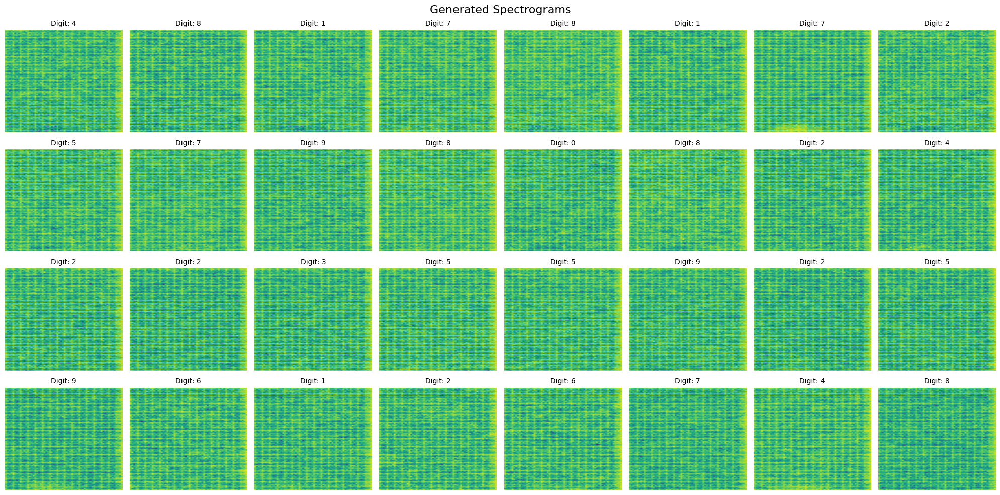

Epoch 1 (training): 100%|██████████| 16/16


Epoch 1, Average train Loss: 56820.34375, Average test Loss: 37060.88671875


Epoch 2 (training): 100%|██████████| 16/16


Epoch 2, Average train Loss: 33027.5546875, Average test Loss: 29470.365234375


Epoch 3 (training): 100%|██████████| 16/16


Epoch 3, Average train Loss: 28358.005859375, Average test Loss: 26842.25390625


Epoch 4 (training): 100%|██████████| 16/16


Epoch 4, Average train Loss: 26419.201171875, Average test Loss: 25526.955078125


Epoch 5 (training): 100%|██████████| 16/16


Epoch 5, Average train Loss: 25163.955078125, Average test Loss: 24364.373046875


Epoch 6 (training): 100%|██████████| 16/16


Epoch 6, Average train Loss: 24248.146484375, Average test Loss: 23680.65234375


Epoch 7 (training): 100%|██████████| 16/16


Epoch 7, Average train Loss: 23517.869140625, Average test Loss: 22964.427734375


Epoch 8 (training): 100%|██████████| 16/16


Epoch 8, Average train Loss: 22908.1640625, Average test Loss: 22742.408203125


Epoch 9 (training): 100%|██████████| 16/16


Epoch 9, Average train Loss: 22166.765625, Average test Loss: 21379.544921875


Epoch 10 (training): 100%|██████████| 16/16


Epoch 10, Average train Loss: 21397.904296875, Average test Loss: 21048.294921875


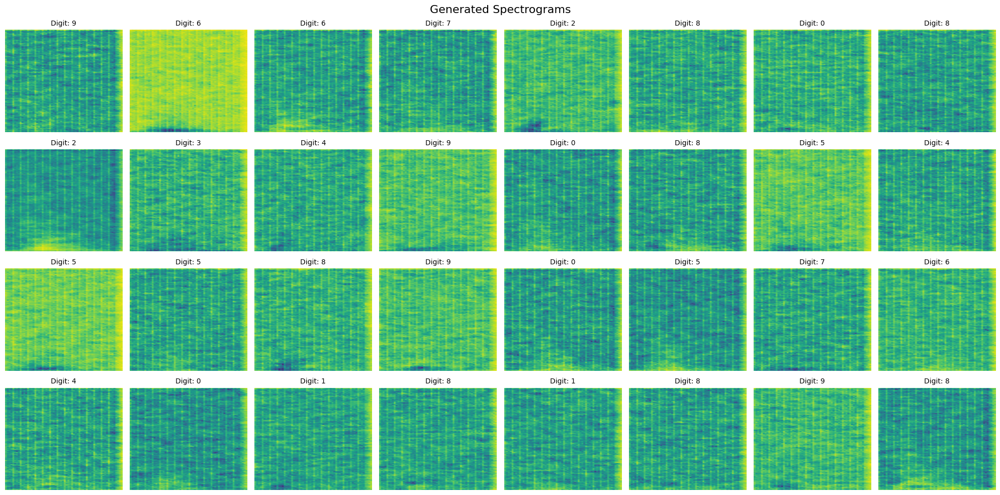

Epoch 11 (training): 100%|██████████| 16/16


Epoch 11, Average train Loss: 20861.4375, Average test Loss: 20400.78125


Epoch 12 (training): 100%|██████████| 16/16


Epoch 12, Average train Loss: 20515.421875, Average test Loss: 20096.830078125


Epoch 13 (training): 100%|██████████| 16/16


Epoch 13, Average train Loss: 20208.064453125, Average test Loss: 19820.92578125


Epoch 14 (training): 100%|██████████| 16/16


Epoch 14, Average train Loss: 19894.69921875, Average test Loss: 19515.0234375


Epoch 15 (training): 100%|██████████| 16/16


Epoch 15, Average train Loss: 19612.412109375, Average test Loss: 19243.59375


Epoch 16 (training): 100%|██████████| 16/16


Epoch 16, Average train Loss: 19488.66796875, Average test Loss: 19215.341796875


Epoch 17 (training): 100%|██████████| 16/16


Epoch 17, Average train Loss: 19299.875, Average test Loss: 18868.03515625


Epoch 18 (training): 100%|██████████| 16/16


Epoch 18, Average train Loss: 19153.14453125, Average test Loss: 19076.57421875


Epoch 19 (training): 100%|██████████| 16/16


Epoch 19, Average train Loss: 18978.072265625, Average test Loss: 18663.484375


Epoch 20 (training): 100%|██████████| 16/16


Epoch 20, Average train Loss: 18911.814453125, Average test Loss: 18869.509765625


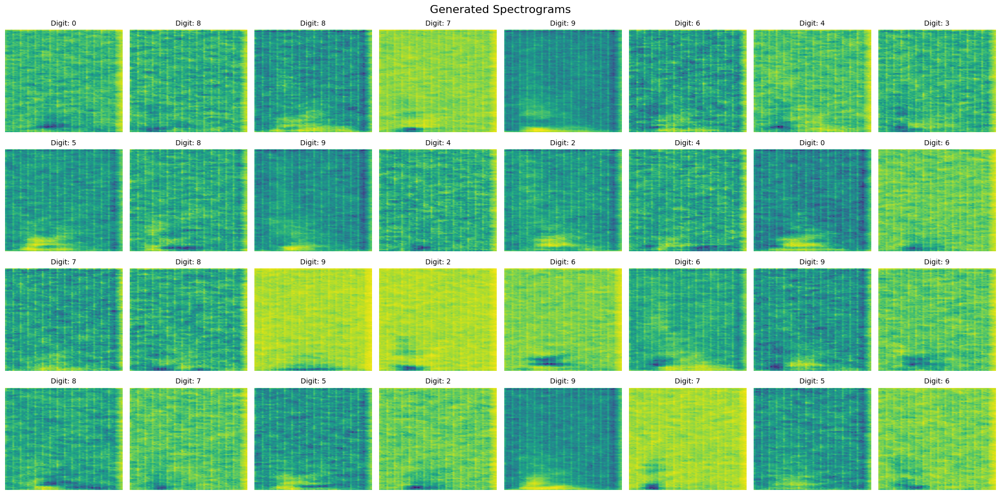

Epoch 21 (training): 100%|██████████| 16/16


Epoch 21, Average train Loss: 18790.994140625, Average test Loss: 18462.419921875


Epoch 22 (training): 100%|██████████| 16/16


Epoch 22, Average train Loss: 18658.228515625, Average test Loss: 18324.67578125


Epoch 23 (training): 100%|██████████| 16/16


Epoch 23, Average train Loss: 18595.220703125, Average test Loss: 18419.376953125


Epoch 24 (training): 100%|██████████| 16/16


Epoch 24, Average train Loss: 45732.25390625, Average test Loss: 33228.7890625


Epoch 25 (training): 100%|██████████| 16/16


Epoch 25, Average train Loss: 202409.34375, Average test Loss: 594036.5625


Epoch 26 (training): 100%|██████████| 16/16


Epoch 26, Average train Loss: 560192.8125, Average test Loss: 174071.453125


Epoch 27 (training): 100%|██████████| 16/16


Epoch 27, Average train Loss: 58812.66796875, Average test Loss: 31590.759765625


Epoch 28 (training): 100%|██████████| 16/16


Epoch 28, Average train Loss: 25440.78515625, Average test Loss: 20988.734375


Epoch 29 (training): 100%|██████████| 16/16


Epoch 29, Average train Loss: 20376.8984375, Average test Loss: 19193.65234375


Epoch 30 (training): 100%|██████████| 16/16


Epoch 30, Average train Loss: 19260.759765625, Average test Loss: 18754.69921875


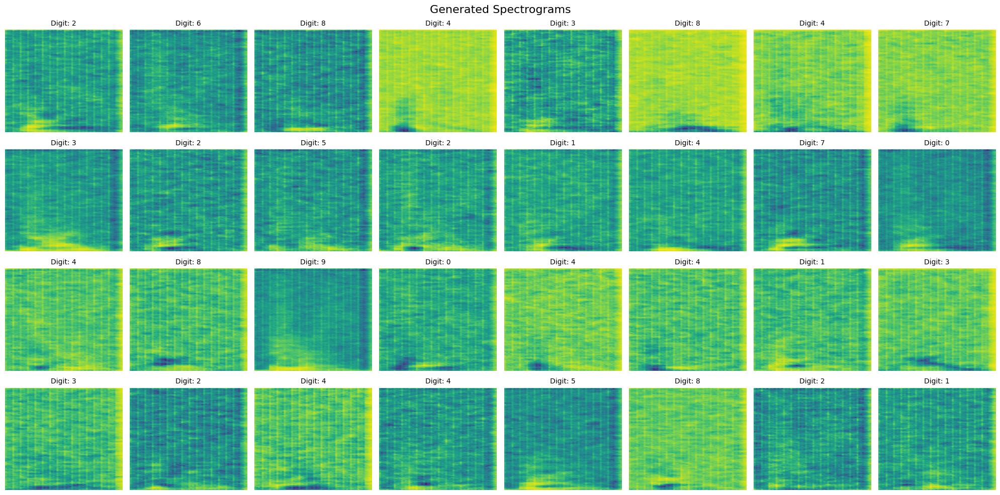

Epoch 31 (training): 100%|██████████| 16/16


Epoch 31, Average train Loss: 18820.9609375, Average test Loss: 18521.5625


Epoch 32 (training): 100%|██████████| 16/16


Epoch 32, Average train Loss: 18599.03125, Average test Loss: 18130.916015625


Epoch 33 (training): 100%|██████████| 16/16


Epoch 33, Average train Loss: 18289.24609375, Average test Loss: 18060.537109375


Epoch 34 (training): 100%|██████████| 16/16


Epoch 34, Average train Loss: 18232.56640625, Average test Loss: 17900.9453125


Epoch 35 (training): 100%|██████████| 16/16


Epoch 35, Average train Loss: 18120.828125, Average test Loss: 17758.6328125


Epoch 36 (training): 100%|██████████| 16/16


Epoch 36, Average train Loss: 18052.330078125, Average test Loss: 17805.578125


Epoch 37 (training): 100%|██████████| 16/16


Epoch 37, Average train Loss: 17986.029296875, Average test Loss: 17688.203125


Epoch 38 (training): 100%|██████████| 16/16


Epoch 38, Average train Loss: 17923.572265625, Average test Loss: 17594.4609375


Epoch 39 (training): 100%|██████████| 16/16


Epoch 39, Average train Loss: 17840.259765625, Average test Loss: 17649.2265625


Epoch 40 (training): 100%|██████████| 16/16


Epoch 40, Average train Loss: 17782.513671875, Average test Loss: 17493.484375


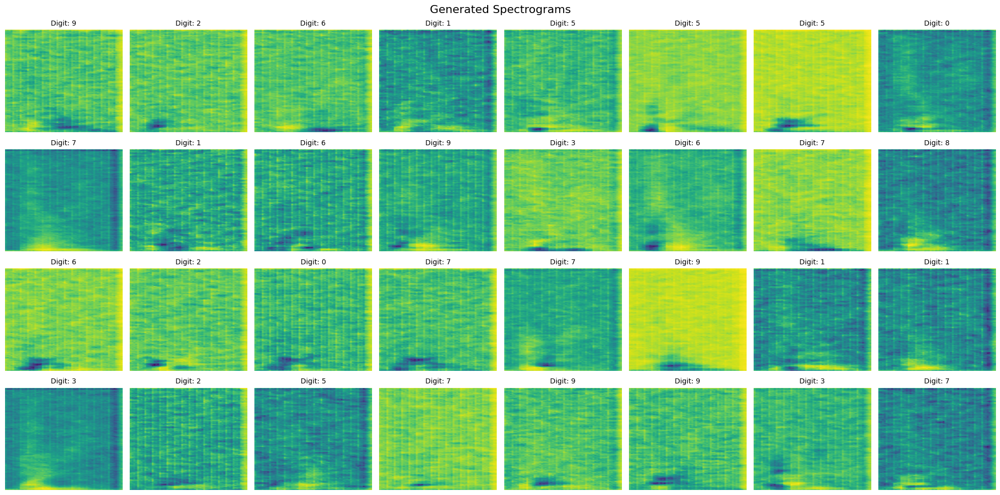

Epoch 41 (training): 100%|██████████| 16/16


Epoch 41, Average train Loss: 17791.51171875, Average test Loss: 17469.890625


Epoch 42 (training): 100%|██████████| 16/16


Epoch 42, Average train Loss: 17703.00390625, Average test Loss: 17376.125


Epoch 43 (training): 100%|██████████| 16/16


Epoch 43, Average train Loss: 17630.015625, Average test Loss: 17290.86328125


Epoch 44 (training): 100%|██████████| 16/16


Epoch 44, Average train Loss: 17576.76171875, Average test Loss: 17284.560546875


Epoch 45 (training): 100%|██████████| 16/16


Epoch 45, Average train Loss: 17599.740234375, Average test Loss: 17307.96484375


Epoch 46 (training): 100%|██████████| 16/16


Epoch 46, Average train Loss: 17547.84375, Average test Loss: 17316.64453125


Epoch 47 (training): 100%|██████████| 16/16


Epoch 47, Average train Loss: 19619.52734375, Average test Loss: 18648.5234375


Epoch 48 (training): 100%|██████████| 16/16


Epoch 48, Average train Loss: 18071.79296875, Average test Loss: 17635.240234375


Epoch 49 (training): 100%|██████████| 16/16


Epoch 49, Average train Loss: 17594.921875, Average test Loss: 17291.1484375


In [94]:
torch.manual_seed(42)
model = VariationalAutoencoder(latent_dim).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = loss_function

trainig_loop(model, train_loader, test_loader, optimizer, criterion, epochs, beta)

In [95]:
# Listen to reconstructed audio (VAE output)
print("\n=== RECONSTRUCTED SAMPLES (VAE) ===")
model.eval()
spectrograms, labels = next(iter(test_loader))
spectrograms_device = spectrograms[:3].to(device)

with torch.no_grad():
    reconstructed, _, _ = model(spectrograms_device)

# Play 3 reconstructed samples
for i in range(3):
    original_spec = spectrograms[i]
    reconstructed_spec = reconstructed[i]
    label = labels[i].item()
    
    print(f"\n--- Sample {i+1} - Digit: {label} ---")
    play_audio_from_spectrogram(original_spec, title="  Original")
    play_audio_from_spectrogram(reconstructed_spec, title="  Reconstructed")


=== RECONSTRUCTED SAMPLES (VAE) ===

--- Sample 1 - Digit: 1 ---

  Original



  Reconstructed



--- Sample 2 - Digit: 6 ---

  Original



  Reconstructed



--- Sample 3 - Digit: 0 ---

  Original



  Reconstructed


In [96]:
# Export the model
torch.save(model.state_dict(), "variational_autoencoder.pth")

In [97]:
# Load the model
model = VariationalAutoencoder(latent_dim).to(device)
model.load_state_dict(torch.load("variational_autoencoder.pth"))

<All keys matched successfully>

In [98]:
# Evaluate the model

model.eval()

# Get the latent representation of the test data
latent_representations = []
latent_representations_labels = []

test_loader_tqdm = tqdm(test_loader,
                        total=(len(test_loader)),
                        desc=f"Getting latent representations",
                        bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt}")

for x, y in test_loader_tqdm:
    x = x.to(device)
    mean, logvar = model.encode(x)
    z = model.reparameterize(mean, logvar)
    latent_representations.append(z.detach().cpu().numpy())
    latent_representations_labels.append(y.numpy())

latent_representations = np.concatenate(latent_representations, axis=0)
latent_representations_labels = np.concatenate(latent_representations_labels, axis=0)
print("Shape of latent representations:", latent_representations.shape)
print("Shape of latent representations labels:", latent_representations_labels.shape)
print("Maximum value in latent representations:", np.max(latent_representations))
print("Minimum value in latent representations:", np.min(latent_representations))

# Visualize the latent representations
tsne = manifold.TSNE(n_components=2, init='pca', random_state=42)
latent_representations_tsne = tsne.fit_transform(latent_representations)
print("Shape of latent representations tsne:", latent_representations_tsne.shape)


Getting latent representations: 100%|██████████| 4/4


Shape of latent representations: (500, 128)
Shape of latent representations labels: (500,)
Maximum value in latent representations: 5.345583
Minimum value in latent representations: -4.848998
Shape of latent representations tsne: (500, 2)


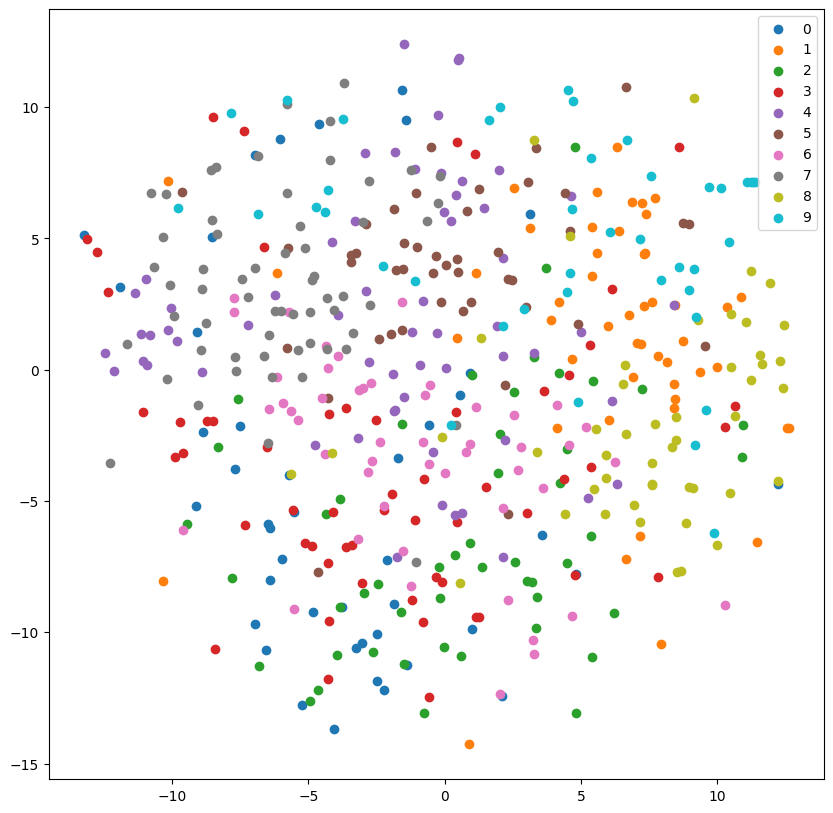

In [99]:
plt.figure(figsize=(10, 10))
for i in range(10):
    indices = latent_representations_labels == i
    plt.scatter(latent_representations_tsne[indices, 0], latent_representations_tsne[indices, 1], label=str(i))
plt.legend()
plt.show()

Shape of the spectrogram tensor: torch.Size([16, 1, 256, 64])
Shape of the reconstructed spectrogram tensor: torch.Size([16, 1, 256, 64])


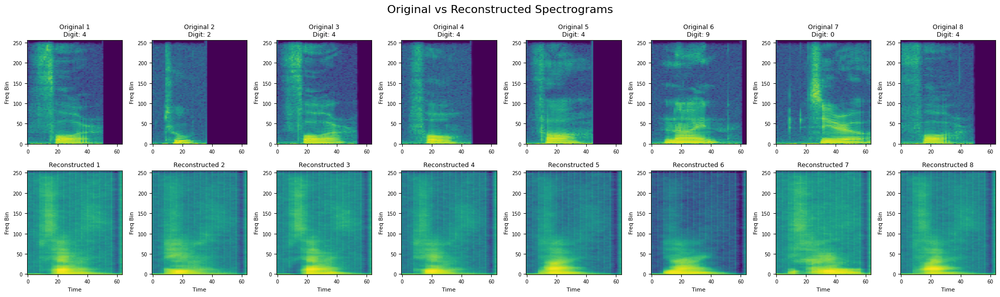

In [100]:
# Reconstruct images

# Get a batch of spectrograms
spectrograms, labels = next(iter(train_loader))
spectrograms_to_show = spectrograms[:16]
print("Shape of the spectrogram tensor:", spectrograms_to_show.shape)

spectrograms_to_show = spectrograms_to_show.to(device)
x_reconstructed, _, _ = model(spectrograms_to_show)
print("Shape of the reconstructed spectrogram tensor:", x_reconstructed.shape)

# Create subplots to show original and reconstructed spectrograms side by side
# 2 rows (original, reconstructed) x 8 columns
fig, axes = plt.subplots(2, 8, figsize=(20, 6))
fig.suptitle('Original vs Reconstructed Spectrograms', fontsize=16)

num_samples = min(8, len(spectrograms_to_show))

for idx in range(num_samples):
    # Get single spectrogram and squeeze channel dimension
    spec = spectrograms_to_show[idx].squeeze().detach().cpu().numpy()
    spec_reconstructed = x_reconstructed[idx].squeeze().detach().cpu().numpy()
    
    # Convert to dB scale for better visualization
    spec_db = 10 * np.log10(spec + 1e-10)
    spec_db_reconstructed = 10 * np.log10(spec_reconstructed + 1e-10)
    
    # Plot original spectrogram (top row)
    im1 = axes[0, idx].imshow(spec_db, aspect='auto', origin='lower', cmap='viridis')
    axes[0, idx].set_title(f'Original {idx + 1}\nDigit: {labels[idx].item()}', fontsize=9)
    axes[0, idx].set_ylabel('Freq Bin', fontsize=8)
    axes[0, idx].tick_params(labelsize=7)
    
    # Plot reconstructed spectrogram (bottom row)
    im2 = axes[1, idx].imshow(spec_db_reconstructed, aspect='auto', origin='lower', cmap='viridis')
    axes[1, idx].set_title(f'Reconstructed {idx + 1}', fontsize=9)
    axes[1, idx].set_xlabel('Time', fontsize=8)
    axes[1, idx].set_ylabel('Freq Bin', fontsize=8)
    axes[1, idx].tick_params(labelsize=7)

# Hide any unused subplots
for idx in range(num_samples, 8):
    axes[0, idx].axis('off')
    axes[1, idx].axis('off')

plt.tight_layout()
plt.show()

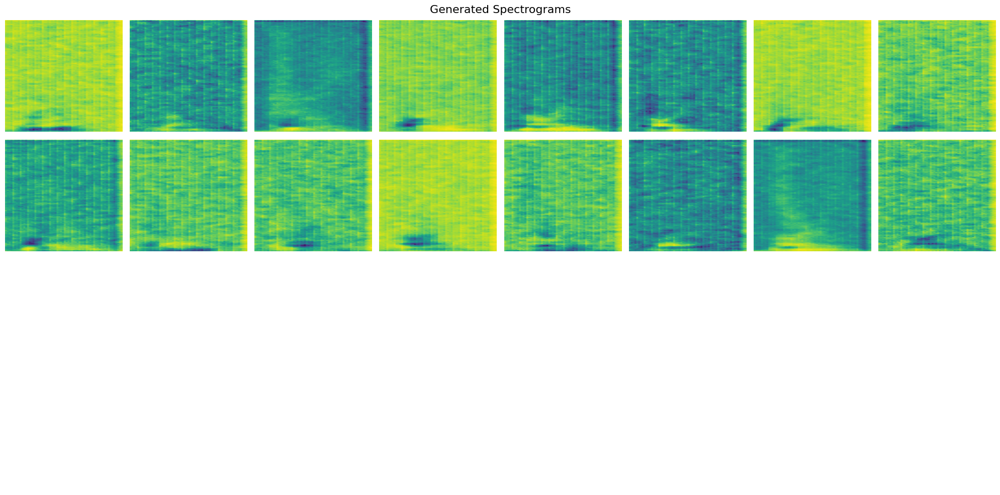


Generated



Generated



Generated



Generated



Generated


In [101]:
# Generate new images

generated_spec = generate_images(model, 16)
plot_images(generated_spec, labels=None) 

with torch.no_grad():
    for i in range(5):
        spec = generated_spec[i]
        play_audio_from_spectrogram(spec, title="Generated")

Shape of latent representations pca: (500, 2)
Explained variance ratio: [0.02572829 0.02252246]
Maximum value in latent representations pca: 5.7775965
Minimum value in latent representations pca: -4.0178757


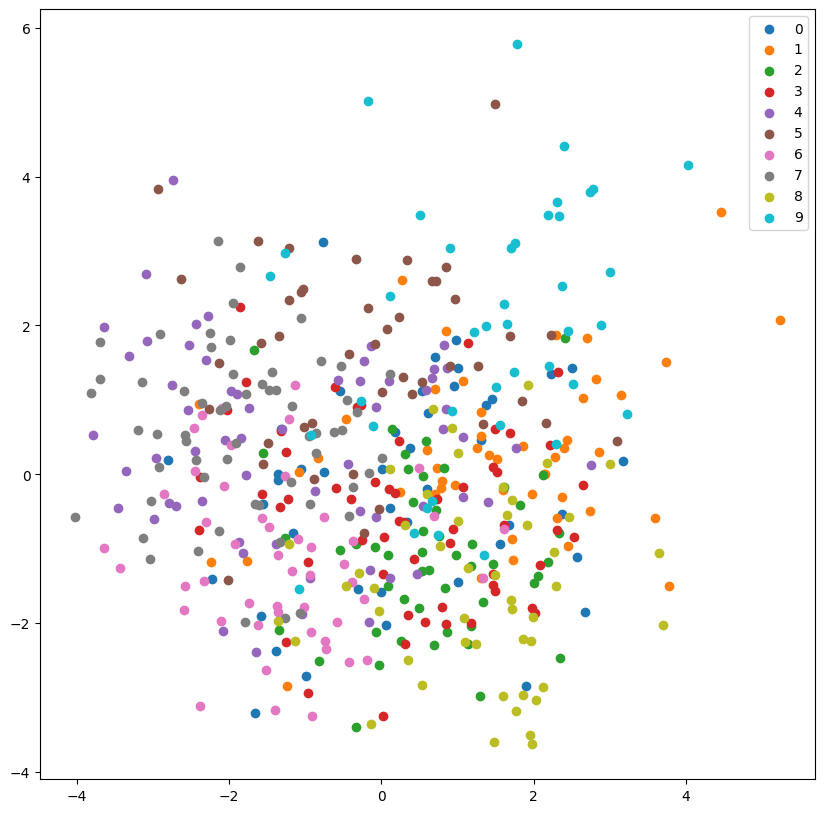

In [ ]:
# Make a pca of the latent representations
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
latent_representations_pca = pca.fit_transform(latent_representations)
print("Shape of latent representations pca:", latent_representations_pca.shape)
print("Explained variance ratio:", pca.explained_variance_ratio_)

print("Maximum value in latent representations pca:", np.max(latent_representations_pca))
print("Minimum value in latent representations pca:", np.min(latent_representations_pca))

plt.figure(figsize=(10, 10))
for i in range(10):
    indices = latent_representations_labels == i
    plt.scatter(latent_representations_pca[indices, 0], latent_representations_pca[indices, 1], label=str(i))
plt.legend()
plt.show()

In [ ]:
inverse_transformed = pca.inverse_transform([[0, 0], [0, 0]])
print("Inverse transformed:", inverse_transformed)

Inverse transformed: [[-0.32923558 -0.33559555 -0.39246923  0.23146103 -0.54184484 -0.35971186
  -0.37384087  0.28210545 -0.34125608  0.26695222 -0.34064814 -0.40823966
   0.36512378 -0.76319027 -0.36655456  0.40846041  0.36414123  0.33026007
   0.27327174  0.25417924 -0.32103661  0.30496714 -0.33684036 -0.28734449
  -0.38661438  0.30184042 -0.42432836 -0.24182773  0.38876593 -0.36839244
   0.26582658  0.30961153 -0.36485904 -0.22506221  0.37307924  0.35097769
  -0.25483277 -0.45568117 -0.18795909 -0.80141222 -0.51000732 -0.33482254
  -0.33937877  0.29334575 -0.28933305  0.42782095 -0.31304193 -0.35675591
  -0.31837037  0.42010504 -0.31818667 -0.43308881  0.34682721 -0.44757089
   0.40131319 -0.43229762  0.39126933 -0.27810571  0.35418677  0.28073868
  -0.43034962 -0.40028983  0.42191184 -0.38481838  0.32473433 -0.30088851
   0.37721032 -0.30266351 -0.30999893  0.33152142  0.43650234 -0.29491076
   0.42992488  0.58042574 -0.30107379 -0.34313214  0.23402044 -0.34773561
  -0.24954985 -0.

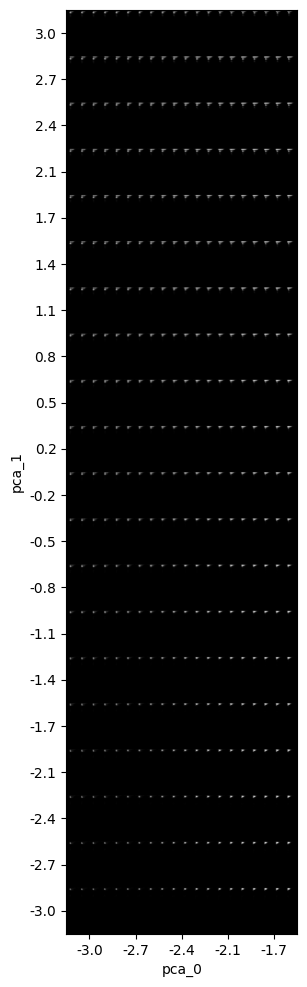

In [ ]:
# Use inverse transform to create maps

n_x = 20
digit_size = [256, 64]
figure_size = 12
scale = 3.

figure = np.zeros((digit_size[0]*n_x, digit_size[1]*n_x))
grid_x = np.linspace(-scale, scale, n_x)
grid_y = np.linspace(scale, -scale, n_x)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        inverse_transformed = pca.inverse_transform([[-xi, -yi]])
        z_sample = torch.tensor(inverse_transformed, dtype=torch.float32).to(device)
        x_decoded = model.decoder(z_sample)
        digit = x_decoded[0].reshape(256, 64).cpu().detach().numpy()
        figure[i*digit_size[0]:(i+1)*digit_size[0],
               j*digit_size[1]:(j+1)*digit_size[1]] = digit

plt.figure(figsize=(figure_size, figure_size))
start_range = digit_size[0] // 2
end_range = n_x * digit_size[0] + start_range
pixel_range = np.arange(start_range, end_range, digit_size[0])
sample_range_x = np.round(grid_x, 1)
sample_range_y = np.round(grid_y, 1)
plt.xticks(pixel_range, sample_range_x)
plt.yticks(pixel_range, sample_range_y)
plt.xlabel("pca_0")
plt.ylabel("pca_1")
plt.imshow(figure, cmap='Greys_r')
plt.show()